In [1]:
import numpy as np
import pandas as pd
from PIL import Image, ImageDraw
from sklearn.utils import shuffle
import random
import tensorflow as tf

from PIL import Image, ImageDraw
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import os
import time
import tensorflow as tf
import datetime

In [2]:
def load(image_file):
  # Read and decode an image file to a uint8 tensor
  image = tf.io.read_file(image_file)
  image = tf.io.decode_jpeg(image)

  # Split each image tensor into two tensors:
  # - one with a real building facade image
  # - one with an architecture label image 
  w = tf.shape(image)[1]
  w = w // 2
  input_image = image[:, w:, :]
  real_image = image[:, :w, :]
  

  
  # Convert both images to float32 tensors
  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)

  return input_image, real_image

In [3]:
def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  return input_image, real_image

def random_crop(input_image, real_image):
  stacked_image = tf.stack([input_image, real_image], axis=0)
  cropped_image = tf.image.random_crop(
      stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])
  return cropped_image[0], cropped_image[1]

def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1
  return input_image, real_image


def random_jitter(input_image, real_image):
  # Resizing to 286x286
  
  input_image, real_image = resize(input_image, real_image, 572, 572) 
  
  input_image, real_image = random_crop(input_image, real_image)
    
  if tf.random.uniform(()) > 0.5:
    # Random mirroring
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)

  return input_image, real_image

In [4]:
def load_image_train(image_file):
    
  input_image, real_image = load(image_file)
  input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [5]:
def load_image_test(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

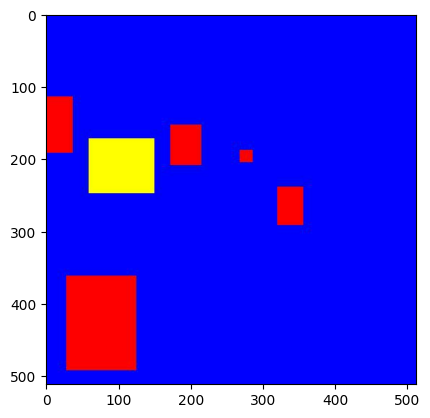

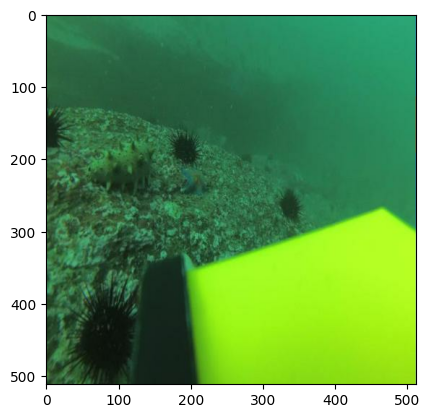

In [6]:
inp, re = load('Dataset/test/merged/0053_jpg.rf.09c5a0f5af288f9426616259b0307fae.jpg')
# Casting to int for matplotlib to display the images
plt.figure()
plt.imshow(inp / 255.0)
plt.figure()
plt.imshow(re / 255.0)

In [7]:
# The facade training set consist of 400 images
BUFFER_SIZE = 400
# The batch size of 1 produced better results for the U-Net in the original pix2pix experiment
BATCH_SIZE = 1
# Each image is 256x256 in size
IMG_WIDTH = 512
IMG_HEIGHT = 512

In [8]:
train_dataset = tf.data.Dataset.list_files('Dataset/train/merged/*.jpg')
train_dataset = train_dataset.map(load_image_train,
                                  num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

#try:
test_dataset = tf.data.Dataset.list_files('Dataset/test/merged/*.jpg')
#except tf.errors.InvalidArgumentError:
  #test_dataset = tf.data.Dataset.list_files('Dataset/valid/mixed_animals/*.jpg')
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

In [9]:
OUTPUT_CHANNELS = 3
def downsample(filters, size, apply_batchnorm=True, strides=2):
    initializer = tf.random_normal_initializer(0., 0.02)

    result = tf.keras.Sequential()
    result.add(
        tf.keras.layers.Conv2D(filters, size, strides=strides, padding='same',
                               kernel_initializer=initializer, use_bias=False))

    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())

    result.add(tf.keras.layers.LeakyReLU())

    return result

down_model = downsample(3, 4)
down_result = down_model(tf.expand_dims(inp, 0))
print (down_result.shape)

def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

up_model = upsample(3, 4)
up_result = up_model(down_result)
print (up_result.shape)

def Generator():
  inputs = tf.keras.layers.Input(shape=[512, 512, 3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  # (batch_size, 128, 128, 64)
    downsample(128, 4),  # (batch_size, 64, 64, 128)
    downsample(256, 4),  # (batch_size, 32, 32, 256)
    downsample(512, 4),  # (batch_size, 16, 16, 512)
    downsample(512, 4),  # (batch_size, 8, 8, 512)
    downsample(512, 4),  # (batch_size, 4, 4, 512)
    downsample(512, 4),  # (batch_size, 2, 2, 512)
    downsample(1024, 4),  # (batch_size, 1, 1, 512)
    downsample(1024, 4),  # (batch_size, 1, 1, 512)
  ]

  up_stack = [
    upsample(1024, 4, apply_dropout=True), 
    upsample(1024, 4, apply_dropout=True),   
    upsample(512, 4, apply_dropout=True), 
    upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 8, 8, 1024)
    upsample(512, 4),  # (batch_size, 16, 16, 1024)
    upsample(256, 4),  # (batch_size, 32, 32, 512)
    upsample(128, 4),  # (batch_size, 64, 64, 256)
    upsample(64, 4),  # (batch_size, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')  # (batch_size, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

generator = Generator()
generator.summary()

(1, 256, 256, 3)
(1, 512, 512, 3)
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential_2 (Sequential)      (None, 256, 256, 64  3072        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 sequential_3 (Sequential)      (None, 128, 128, 12  131584      ['sequential_2[0][0]']           
                                8)                          

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


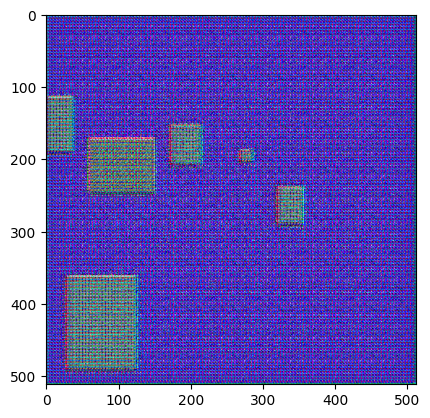

In [10]:
gen_output = generator(inp[tf.newaxis, ...], training=False)
plt.imshow(gen_output[0, ...])

In [11]:
LAMBDA = 100
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

In [12]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[512, 512, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[512, 512, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)
  down4 = downsample(512, 4)(down3)
  down5 = downsample(1024, 4)(down3)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down5)  # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)


In [13]:
discriminator= Discriminator()
discriminator.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_image (InputLayer)       [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 target_image (InputLayer)      [(None, 512, 512, 3  0           []                               
                                )]                                                                
                                                                                                  
 concatenate_8 (Concatenate)    (None, 512, 512, 6)  0           ['input_image[0][0]',            
                                                                  'target_image[0][0]']     

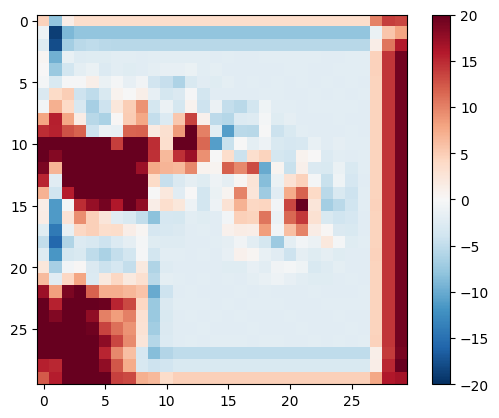

In [14]:
disc_out = discriminator([inp[tf.newaxis, ...], gen_output], training=False)
plt.imshow(disc_out[0, ..., -1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()


In [15]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

In [16]:
class Pix2Pix(tf.keras.Model):
    def __init__(self, generator, discriminator):
        super(Pix2Pix, self).__init__()
        self.generator = generator
        self.discriminator = discriminator

    def compile(self, g_optimizer, d_optimizer, gen_loss_fn, disc_loss_fn):
        super(Pix2Pix, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.gen_loss_fn = gen_loss_fn
        self.disc_loss_fn = disc_loss_fn
        

    def train_step(self, data):
        input_image, target = data

        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
            gen_output = self.generator(input_image, training=True)
            disc_real_output = self.discriminator([input_image, target], training=True)
            disc_generated_output = self.discriminator([input_image, gen_output], training=True)

            gen_total_loss, gen_gan_loss, gen_l1_loss = self.gen_loss_fn(disc_generated_output, gen_output, target)
            disc_loss = self.disc_loss_fn(disc_real_output, disc_generated_output)

        generator_gradients = gen_tape.gradient(gen_total_loss, self.generator.trainable_variables)
        discriminator_gradients = disc_tape.gradient(disc_loss, self.discriminator.trainable_variables)

        self.g_optimizer.apply_gradients(zip(generator_gradients, self.generator.trainable_variables))
        self.d_optimizer.apply_gradients(zip(discriminator_gradients, self.discriminator.trainable_variables))

        return {'gen_total_loss': gen_total_loss, 'disc_loss': disc_loss}
    
    def call(self, inputs, training=False):
        # Aquí definimos el flujo de datos a través del modelo durante la inferencia
        if training:
            # Durante el entrenamiento, solo necesitamos el generador
            generated_image = self.generator(inputs, training=False)
            return self.discriminator([inputs, generated_image], training=False)
            
        else:
            # Durante la inferencia, generamos la salida y la pasamos a través del discriminador       
            return self.generator(inputs, training=True)


In [17]:
def plot_sample_images(dataset, model, num_samples=1):
    for input_image, target in dataset.take(num_samples):
        prediction = model(input_image,training=False)
        plt.figure(figsize=(15, 5))

        display_list = [input_image[0], target[0], prediction[0]]
        title = ['Input Image', 'Ground Truth', 'Predicted Image']

        for i in range(3):
            plt.subplot(1, 3, i+1)
            plt.title(title[i])
            # Ajusta esta línea si tu rango de datos es diferente
            plt.imshow((display_list[i] * 0.5 + 0.5).numpy())
            plt.axis('off')
        plt.show()

In [18]:
from tensorflow.keras.callbacks import ReduceLROnPlateau, LambdaCallback
def on_epoch_end_callback(epoch, logs):
    # Guardar las métricas
    metrics_filename = os.path.join(model_directory, f'metrics_epoch_{epoch+1}.txt')
    with open(metrics_filename, 'w') as f:
        for metric, value in logs.items():
            f.write(f'{metric}: {value}\n')

    # Guardar los pesos del modelo
    model_weights_filename = os.path.join(model_directory, f'model_weights_epoch_{epoch+1}.h5')
    model.generator.save_weights(model_weights_filename)

    # Generar y guardar algunas imágenes de muestra
    plot_sample_images(test_dataset, model)

epoch_end_callback = LambdaCallback(on_epoch_end=on_epoch_end_callback)

reduce_lr_g = ReduceLROnPlateau(monitor='gen_total_loss', factor=0.1, patience=10, verbose=1, mode='auto', min_delta=0.0001, cooldown=0, min_lr=0)
reduce_lr_d = ReduceLROnPlateau(monitor='disc_loss', factor=0.1, patience=10, verbose=1, mode='auto', min_delta=0.0001, cooldown=0, min_lr=0)


Epoch 1/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 22.2003 - disc_loss: 0.9156

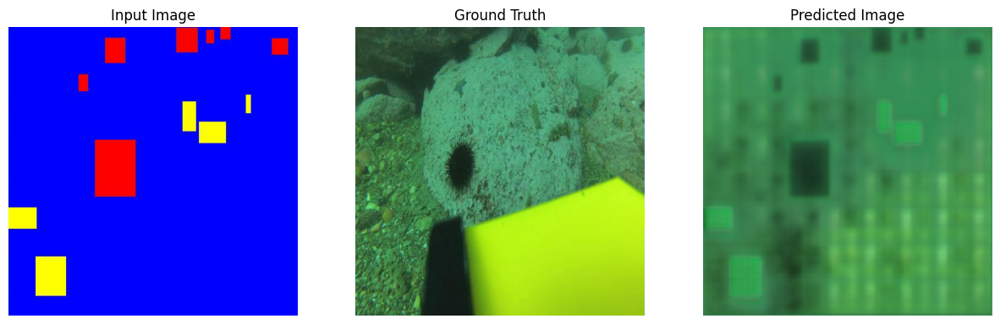

2115/2115 [==============================] - 743s 347ms/step - gen_total_loss: 22.1990 - disc_loss: 0.9154
Epoch 2/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 21.3549 - disc_loss: 0.8111

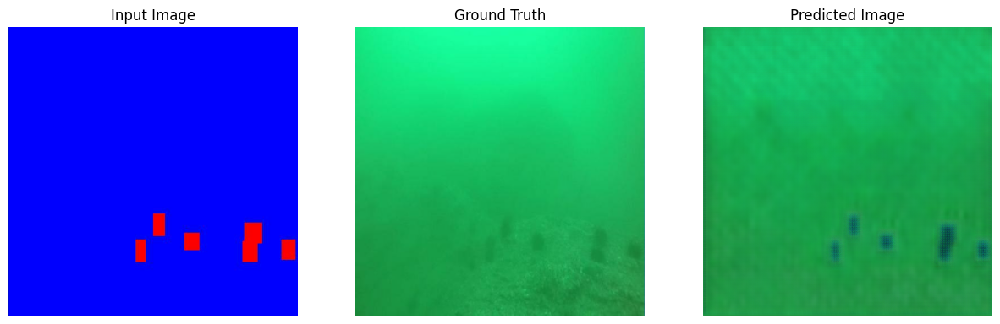

2115/2115 [==============================] - 737s 347ms/step - gen_total_loss: 21.3497 - disc_loss: 0.8116
Epoch 3/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 20.8449 - disc_loss: 0.8471

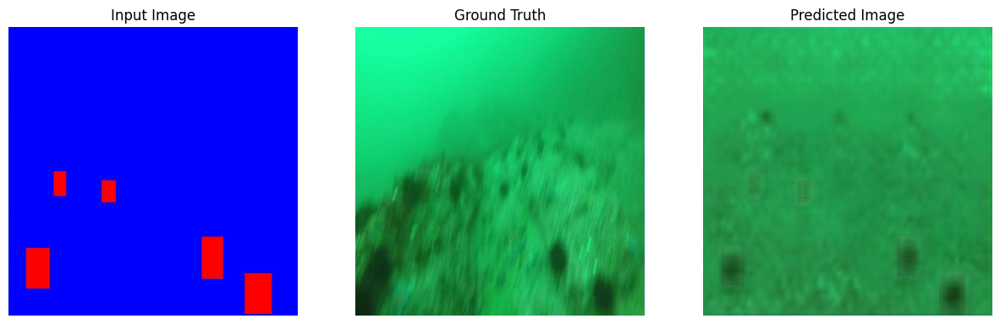

2115/2115 [==============================] - 737s 348ms/step - gen_total_loss: 20.8419 - disc_loss: 0.8472
Epoch 4/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 20.4452 - disc_loss: 0.8232

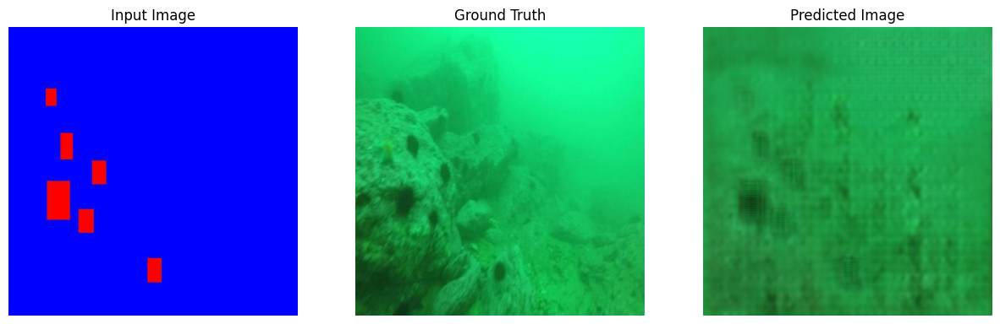

2115/2115 [==============================] - 737s 347ms/step - gen_total_loss: 20.4439 - disc_loss: 0.8229
Epoch 5/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 20.2639 - disc_loss: 0.8031

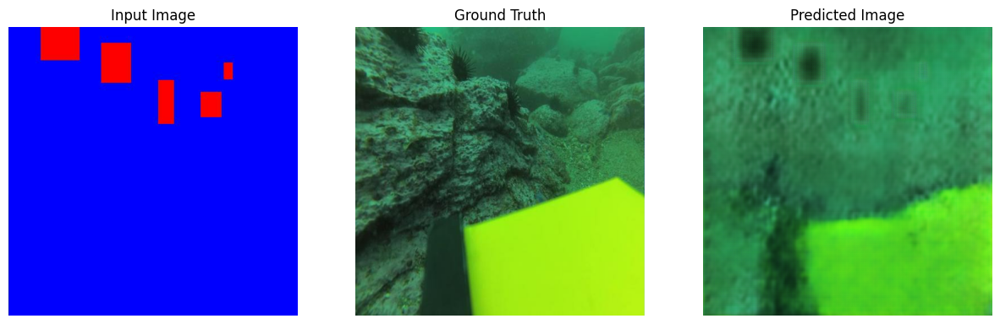

2115/2115 [==============================] - 737s 348ms/step - gen_total_loss: 20.2662 - disc_loss: 0.8029
Epoch 6/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 19.9517 - disc_loss: 0.8012

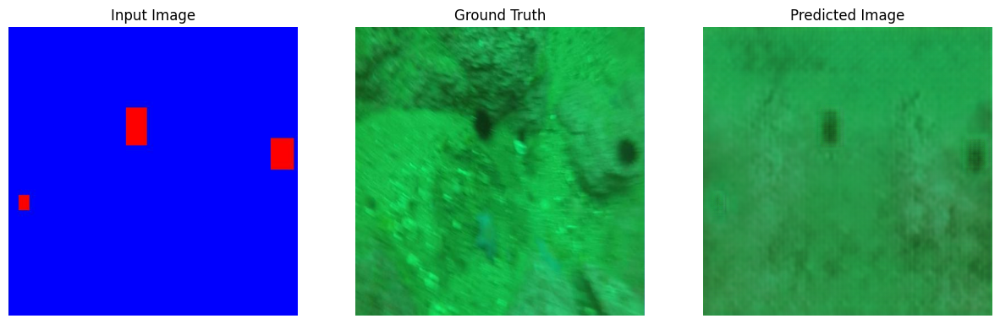

2115/2115 [==============================] - 738s 348ms/step - gen_total_loss: 19.9483 - disc_loss: 0.8009
Epoch 7/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 19.8941 - disc_loss: 0.7892

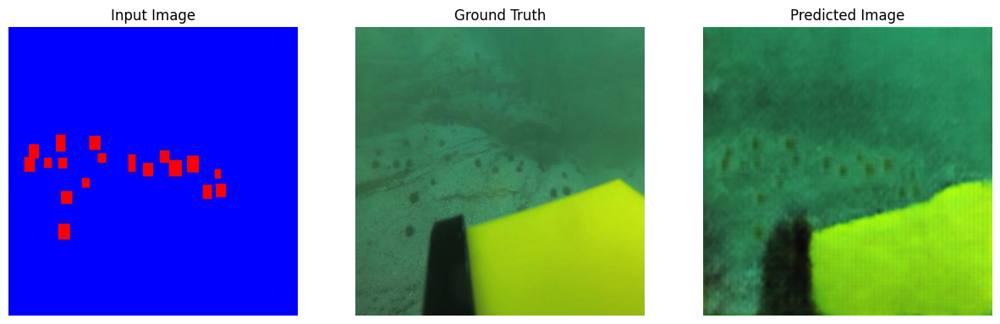

2115/2115 [==============================] - 738s 348ms/step - gen_total_loss: 19.8890 - disc_loss: 0.7899
Epoch 8/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 19.7628 - disc_loss: 0.7686

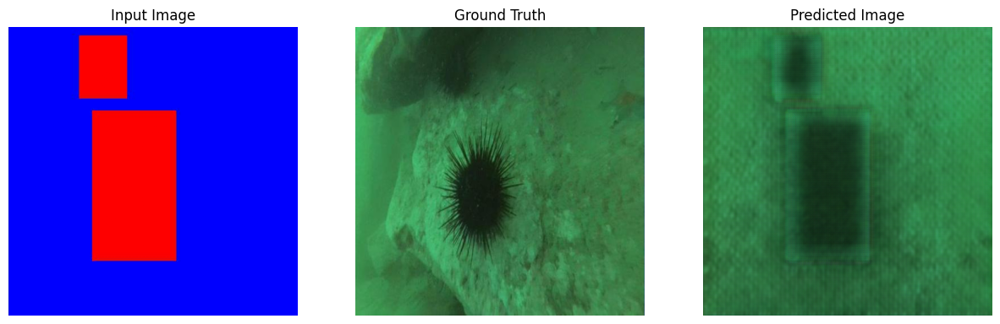

2115/2115 [==============================] - 737s 347ms/step - gen_total_loss: 19.7603 - disc_loss: 0.7685
Epoch 9/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 19.5978 - disc_loss: 0.7793

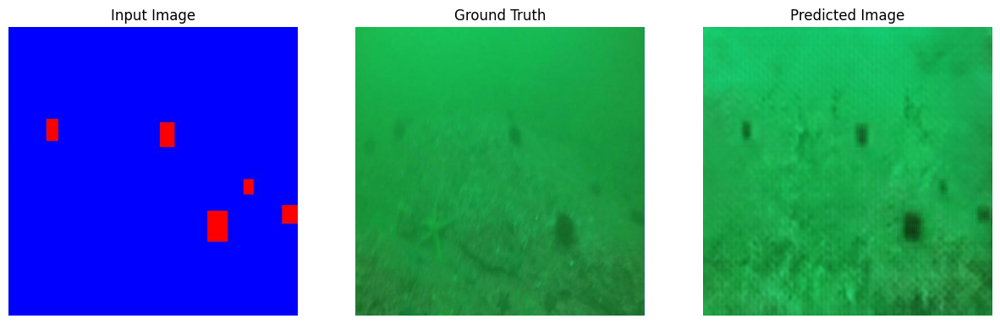

2115/2115 [==============================] - 735s 347ms/step - gen_total_loss: 19.5950 - disc_loss: 0.7797
Epoch 10/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 19.5970 - disc_loss: 0.7632

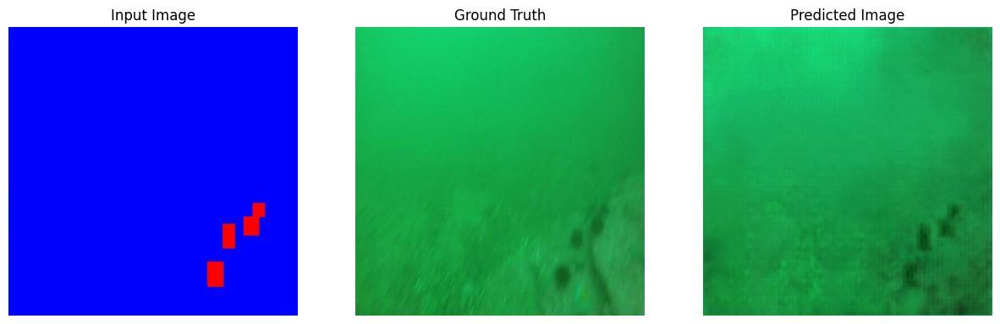

2115/2115 [==============================] - 737s 347ms/step - gen_total_loss: 19.5950 - disc_loss: 0.7633
Epoch 11/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 19.2720 - disc_loss: 0.7715

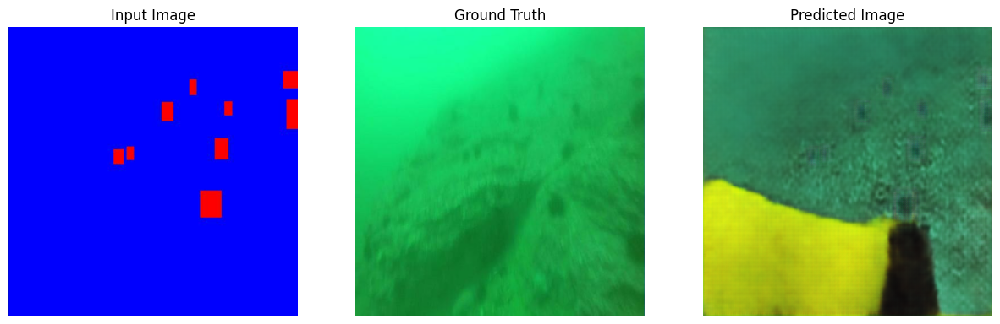

2115/2115 [==============================] - 735s 347ms/step - gen_total_loss: 19.2690 - disc_loss: 0.7716
Epoch 12/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 19.3708 - disc_loss: 0.7645

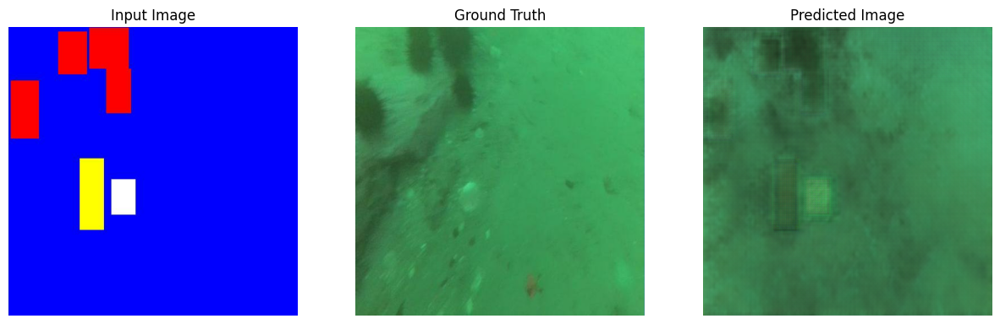

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 19.3698 - disc_loss: 0.7643
Epoch 13/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 19.1233 - disc_loss: 0.7727

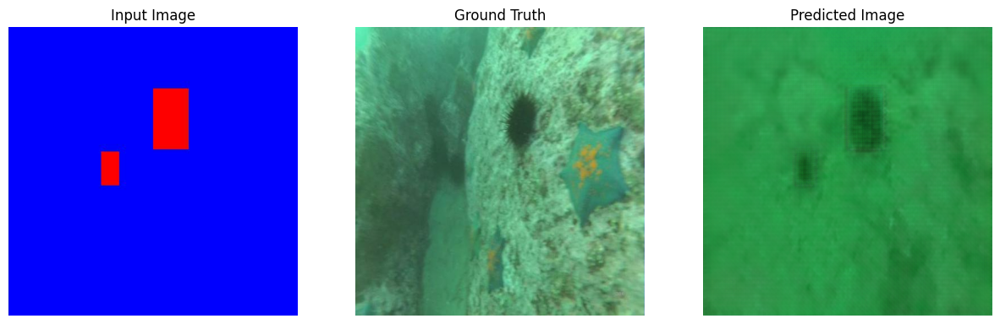

2115/2115 [==============================] - 735s 347ms/step - gen_total_loss: 19.1214 - disc_loss: 0.7726
Epoch 14/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 19.3439 - disc_loss: 0.7603

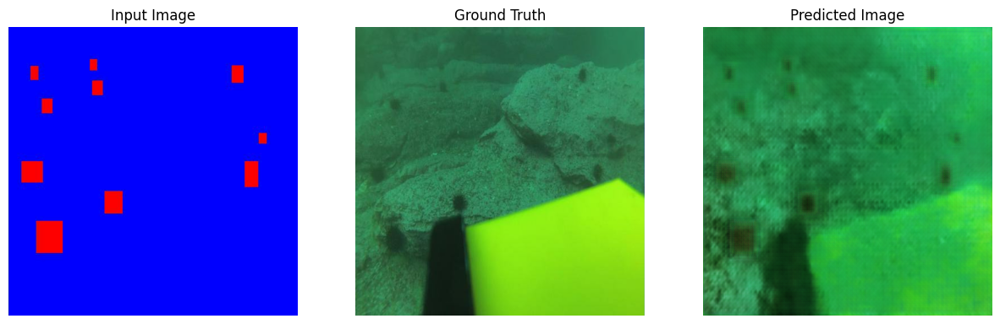

2115/2115 [==============================] - 735s 347ms/step - gen_total_loss: 19.3456 - disc_loss: 0.7601
Epoch 15/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.9856 - disc_loss: 0.7821

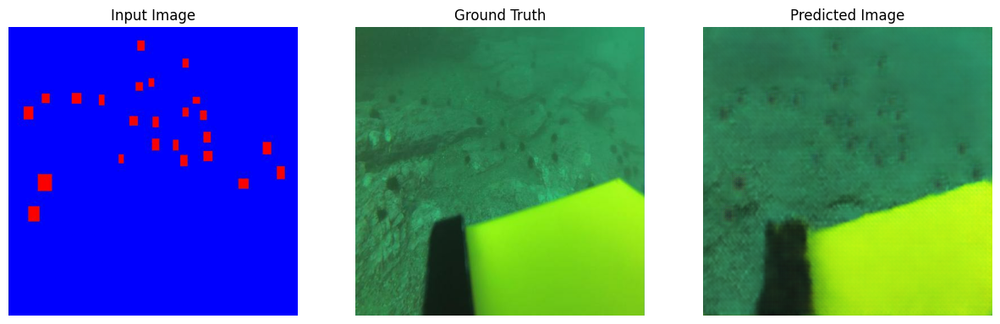

2115/2115 [==============================] - 737s 348ms/step - gen_total_loss: 18.9828 - disc_loss: 0.7818
Epoch 16/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.9092 - disc_loss: 0.7705

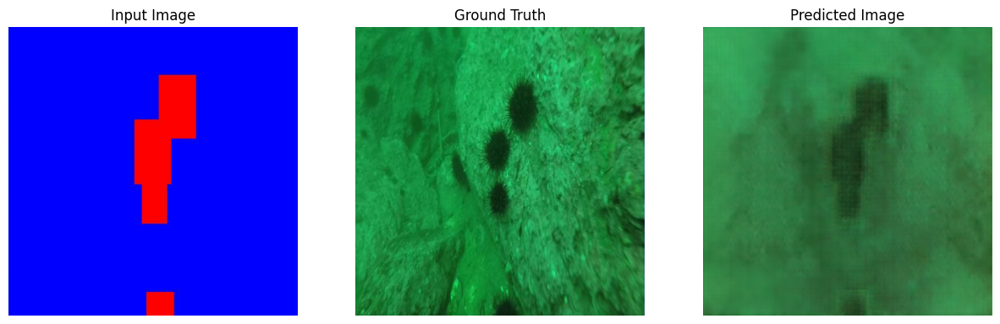

2115/2115 [==============================] - 738s 348ms/step - gen_total_loss: 18.9122 - disc_loss: 0.7703
Epoch 17/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 19.0025 - disc_loss: 0.7721

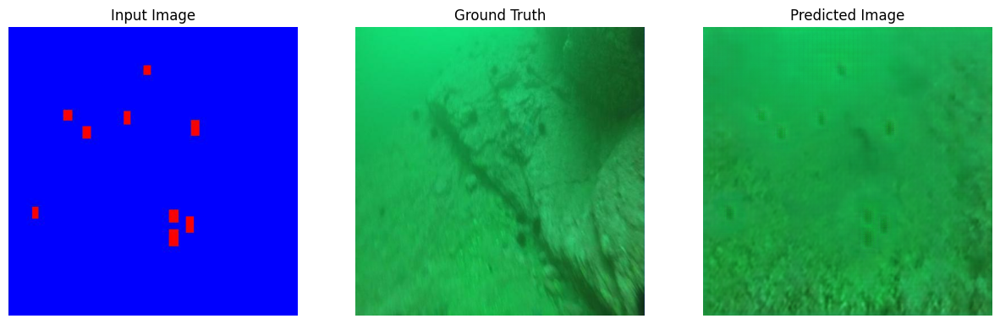

2115/2115 [==============================] - 735s 347ms/step - gen_total_loss: 19.0048 - disc_loss: 0.7719
Epoch 18/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.8290 - disc_loss: 0.7599

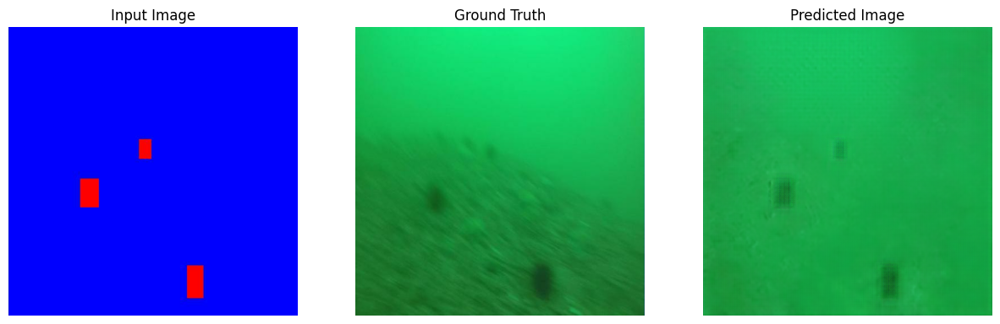

2115/2115 [==============================] - 735s 347ms/step - gen_total_loss: 18.8291 - disc_loss: 0.7598
Epoch 19/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.7440 - disc_loss: 0.7703

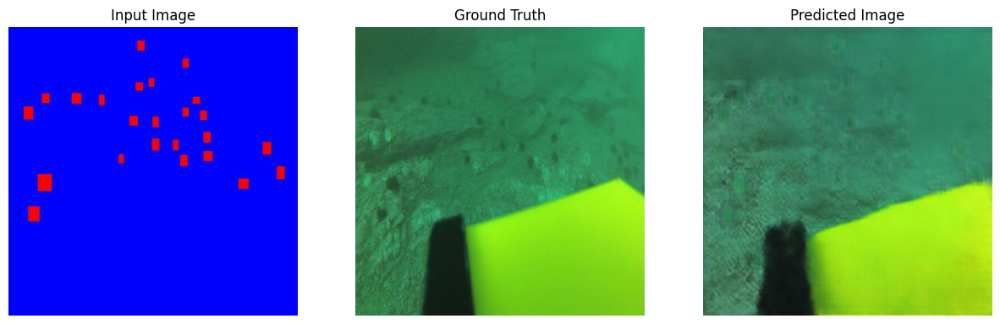

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 18.7445 - disc_loss: 0.7700
Epoch 20/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.8141 - disc_loss: 0.7459

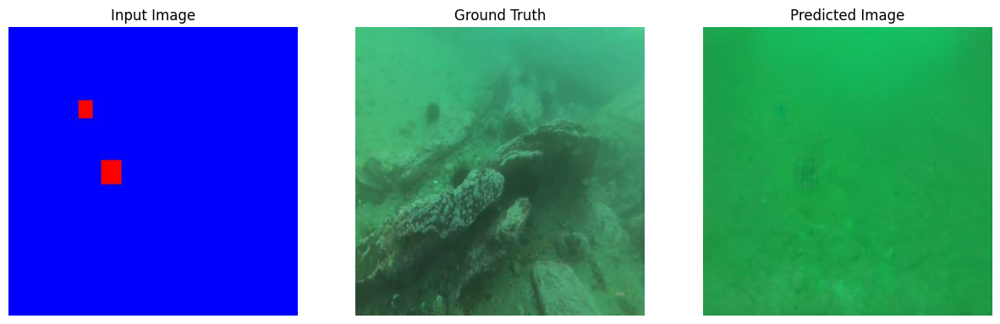

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 18.8208 - disc_loss: 0.7456
Epoch 21/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.7718 - disc_loss: 0.7505

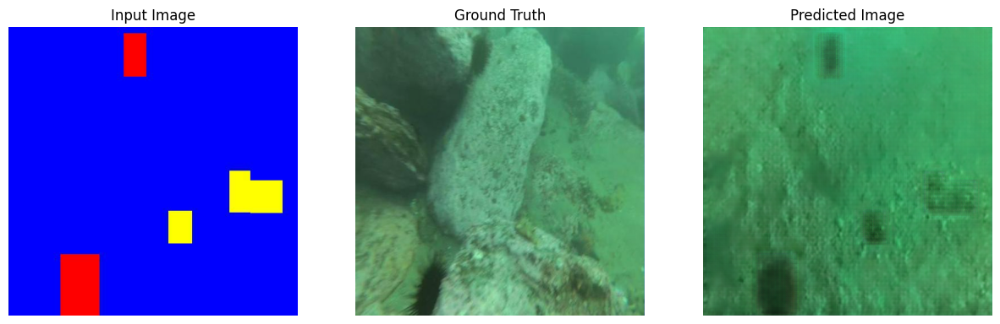

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 18.7695 - disc_loss: 0.7504
Epoch 22/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.4902 - disc_loss: 0.7559

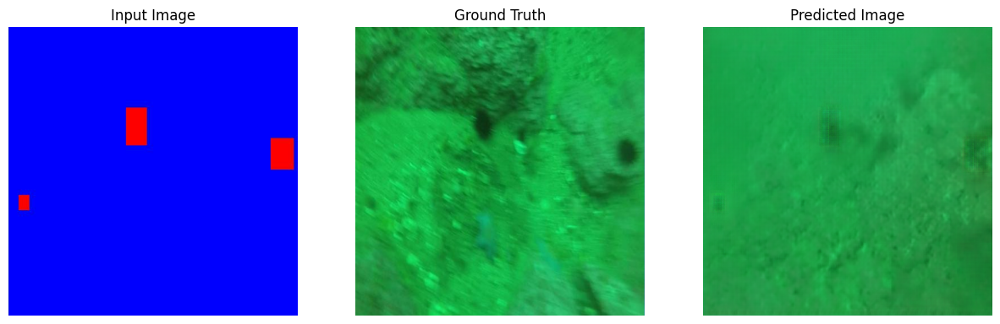

2115/2115 [==============================] - 735s 346ms/step - gen_total_loss: 18.4966 - disc_loss: 0.7558
Epoch 23/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.4481 - disc_loss: 0.7582

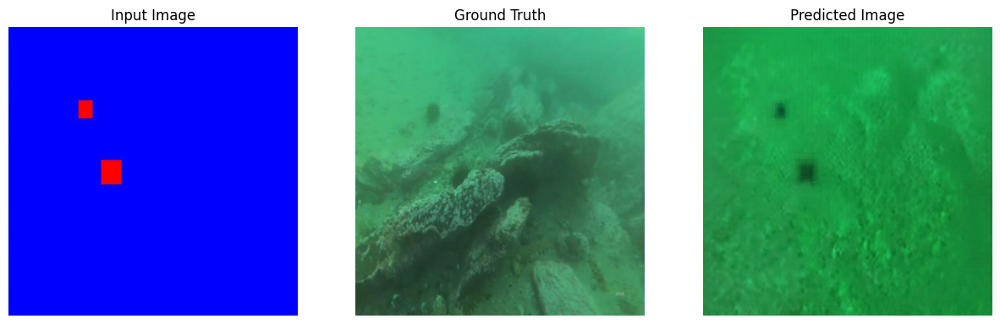

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 18.4471 - disc_loss: 0.7581
Epoch 24/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.3990 - disc_loss: 0.7408

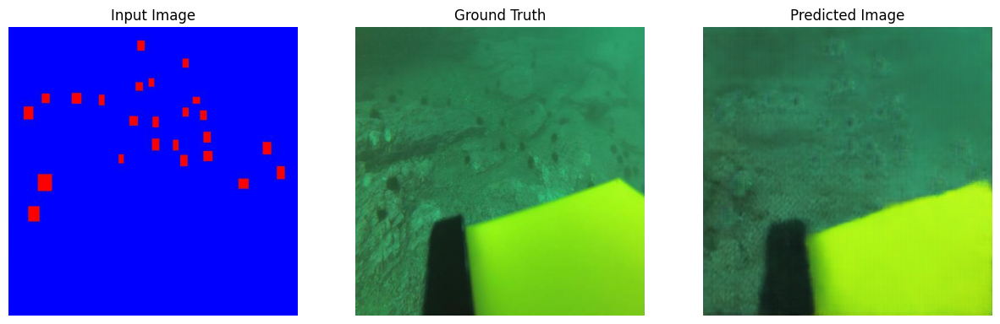

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 18.3973 - disc_loss: 0.7411
Epoch 25/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.3638 - disc_loss: 0.7608

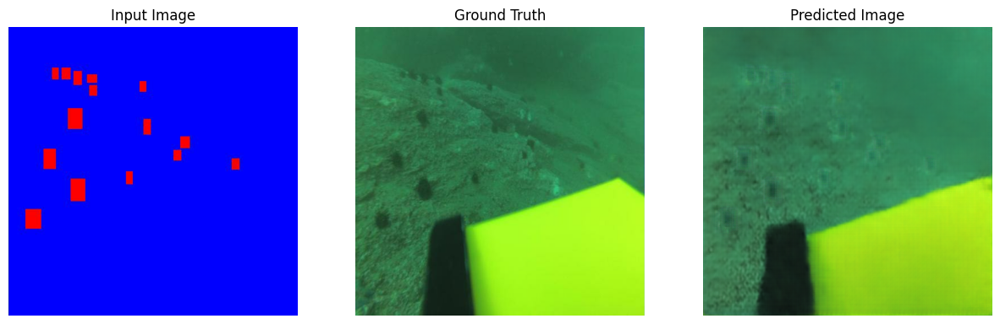

2115/2115 [==============================] - 737s 347ms/step - gen_total_loss: 18.3706 - disc_loss: 0.7606
Epoch 26/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.3249 - disc_loss: 0.7452

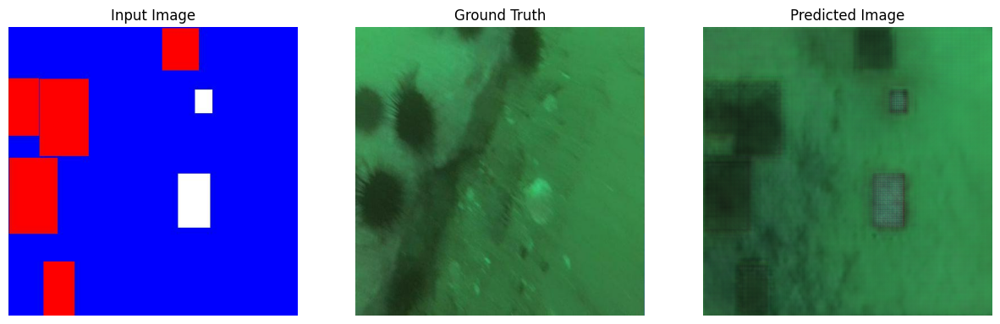

2115/2115 [==============================] - 737s 347ms/step - gen_total_loss: 18.3249 - disc_loss: 0.7450
Epoch 27/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.3208 - disc_loss: 0.7576

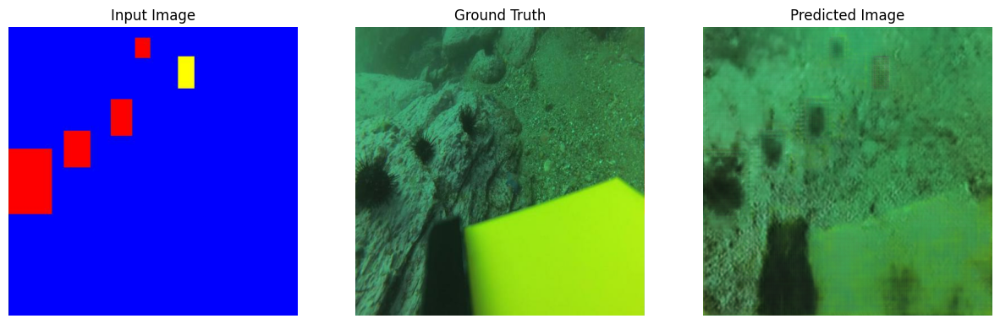

2115/2115 [==============================] - 735s 347ms/step - gen_total_loss: 18.3196 - disc_loss: 0.7574
Epoch 28/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.1789 - disc_loss: 0.7446

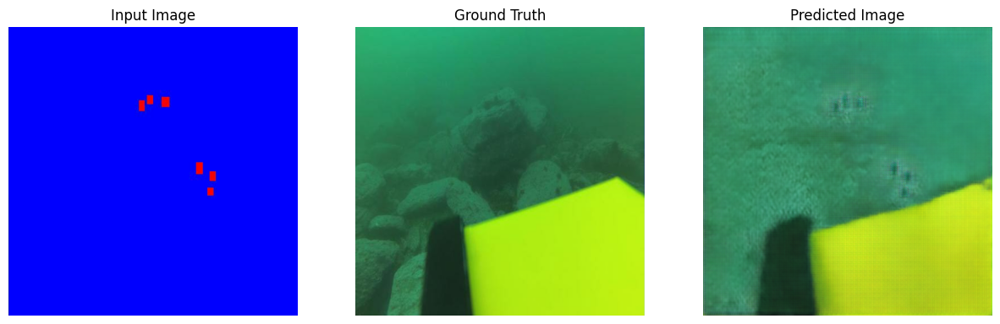

2115/2115 [==============================] - 737s 347ms/step - gen_total_loss: 18.1815 - disc_loss: 0.7443
Epoch 29/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.2021 - disc_loss: 0.7550

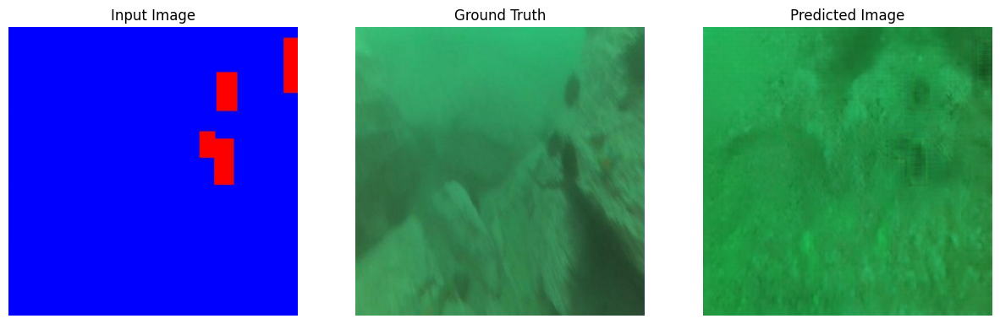

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 18.1975 - disc_loss: 0.7554
Epoch 30/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.2767 - disc_loss: 0.7483

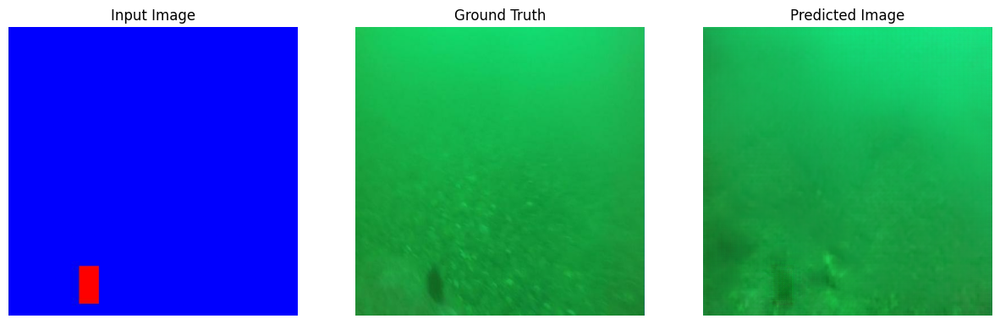

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 18.2804 - disc_loss: 0.7482
Epoch 31/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.0543 - disc_loss: 0.7382

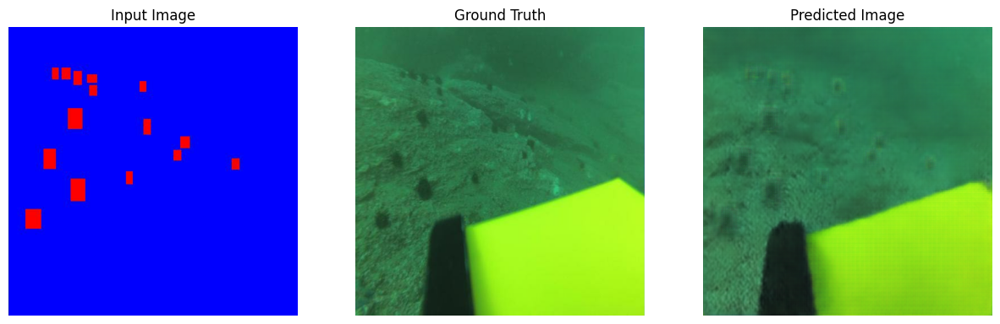

2115/2115 [==============================] - 737s 347ms/step - gen_total_loss: 18.0540 - disc_loss: 0.7388
Epoch 32/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 18.0691 - disc_loss: 0.7472

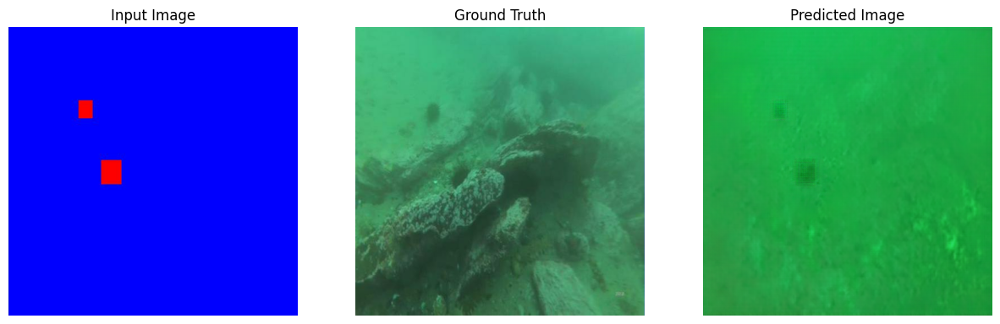

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 18.0660 - disc_loss: 0.7472
Epoch 33/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.9480 - disc_loss: 0.7430

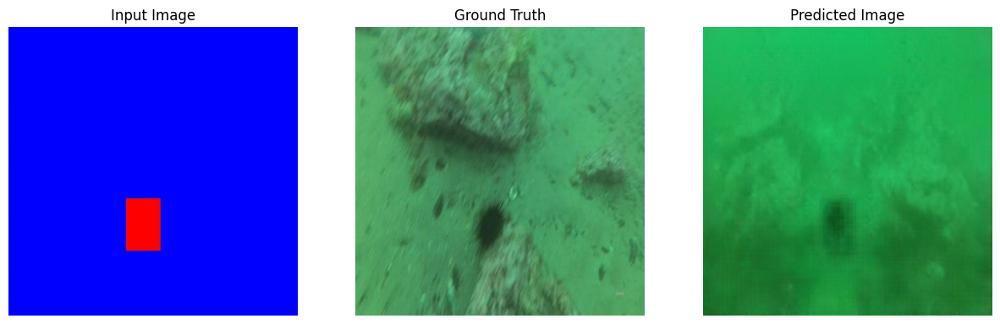

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 17.9468 - disc_loss: 0.7434
Epoch 34/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.9350 - disc_loss: 0.7533

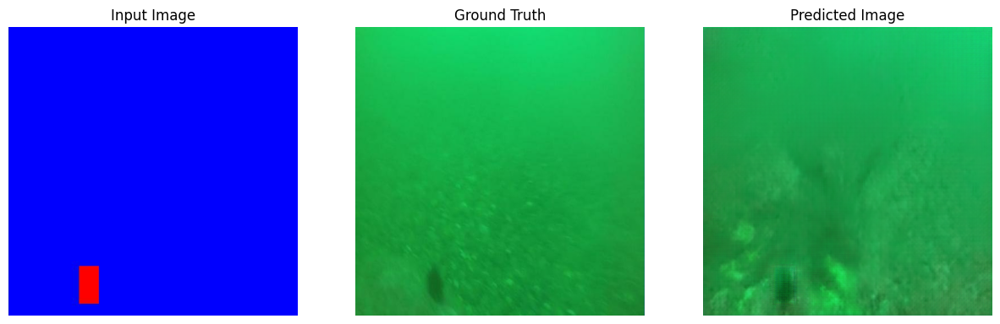

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 17.9320 - disc_loss: 0.7531
Epoch 35/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.9360 - disc_loss: 0.7524

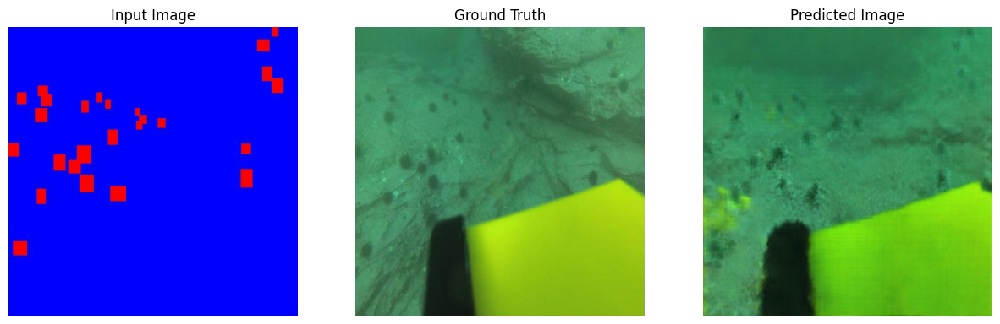

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 17.9337 - disc_loss: 0.7522
Epoch 36/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.8946 - disc_loss: 0.7397

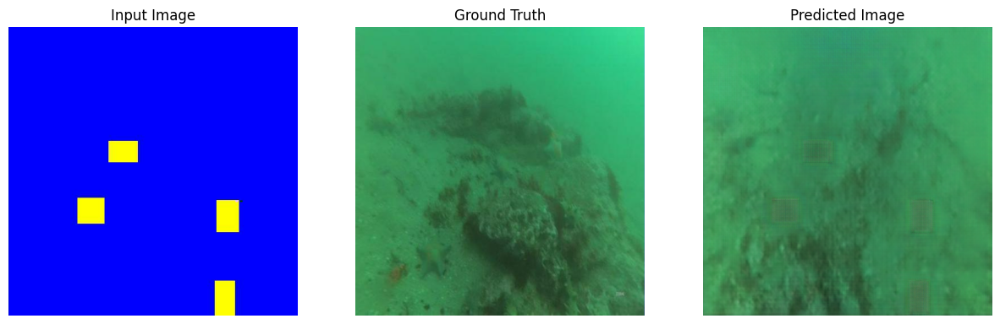

2115/2115 [==============================] - 738s 348ms/step - gen_total_loss: 17.8960 - disc_loss: 0.7394
Epoch 37/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.8376 - disc_loss: 0.7455

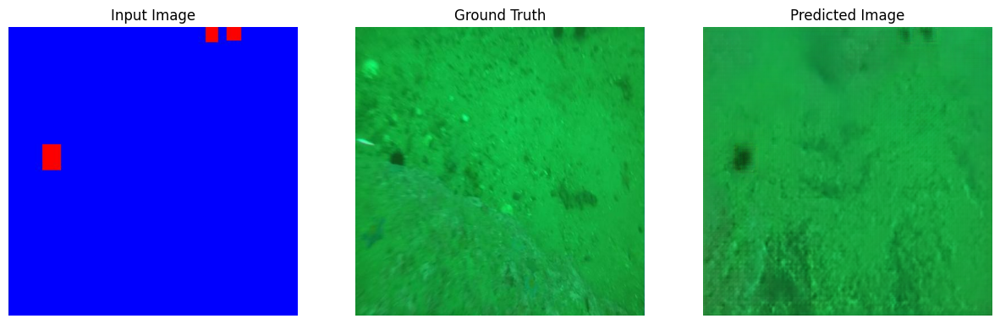

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 17.8345 - disc_loss: 0.7466
Epoch 38/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.7802 - disc_loss: 0.7483

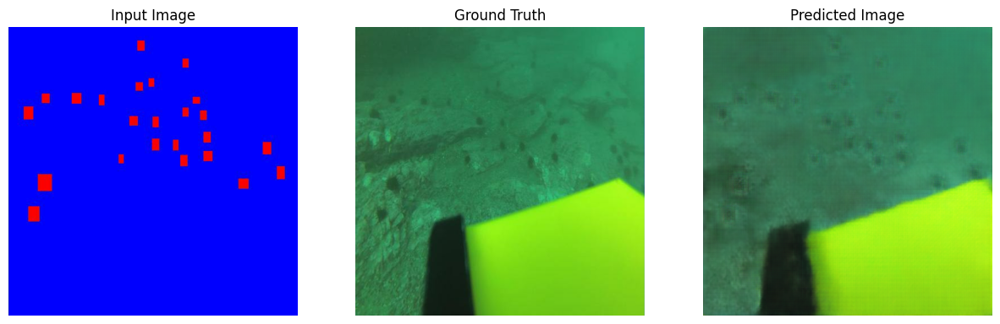

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 17.7800 - disc_loss: 0.7480
Epoch 39/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.6416 - disc_loss: 0.7524

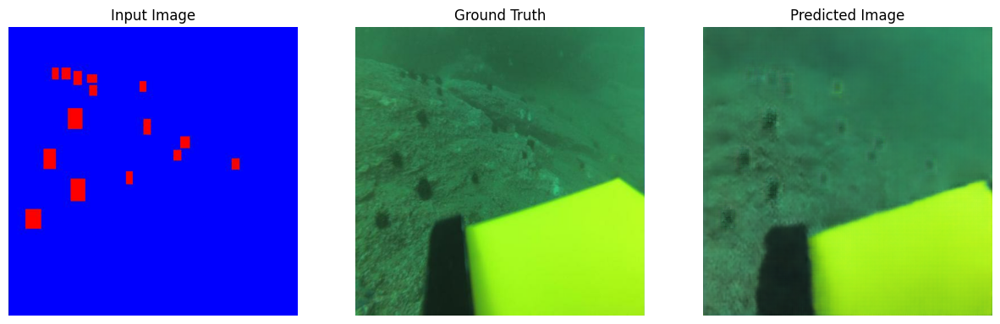

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 17.6452 - disc_loss: 0.7521
Epoch 40/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.7903 - disc_loss: 0.7418

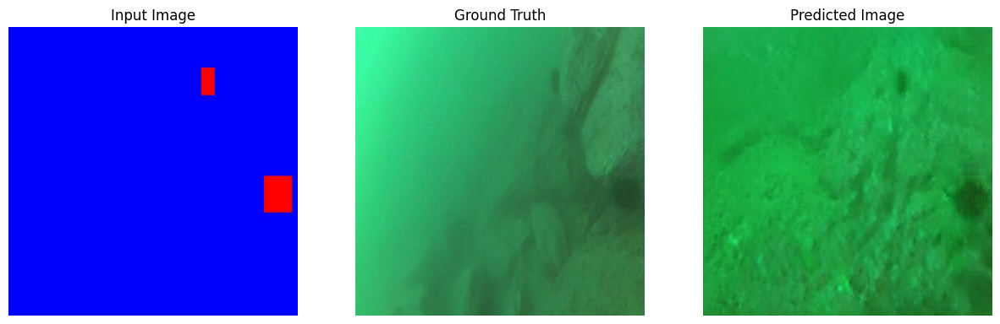

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 17.7881 - disc_loss: 0.7417
Epoch 41/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.6966 - disc_loss: 0.7327

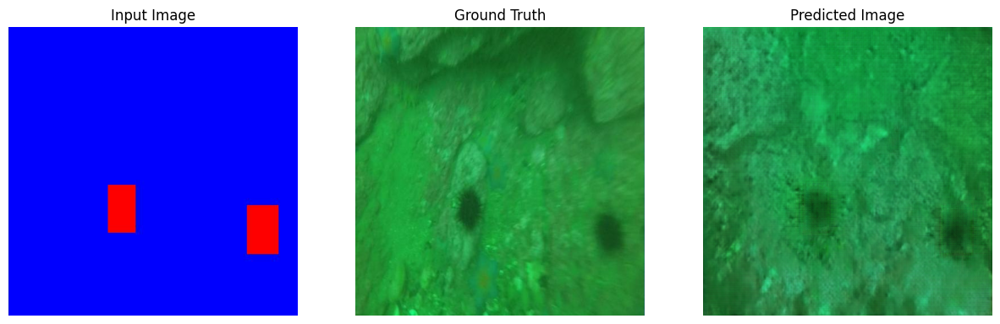

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 17.7012 - disc_loss: 0.7324
Epoch 42/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.6630 - disc_loss: 0.7573

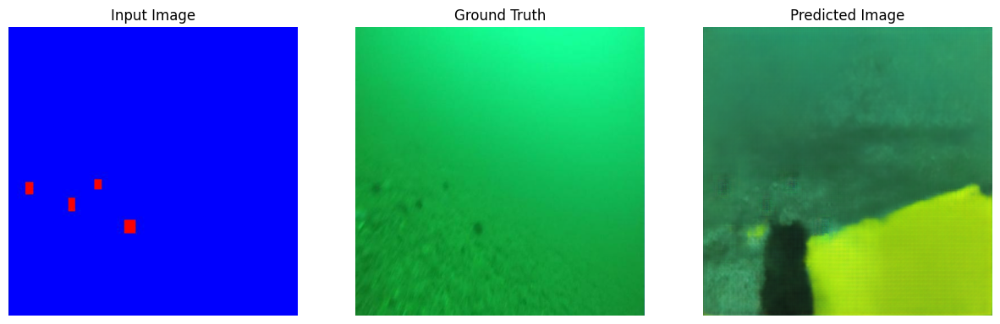

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 17.6611 - disc_loss: 0.7581
Epoch 43/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.5989 - disc_loss: 0.7394

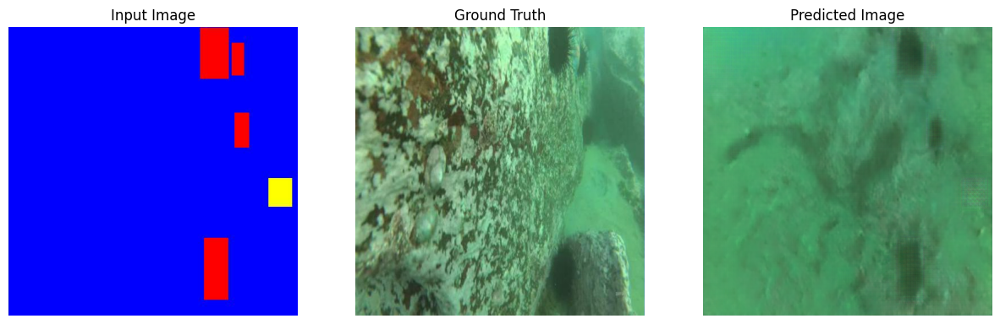

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 17.6013 - disc_loss: 0.7398
Epoch 44/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.4312 - disc_loss: 0.7505

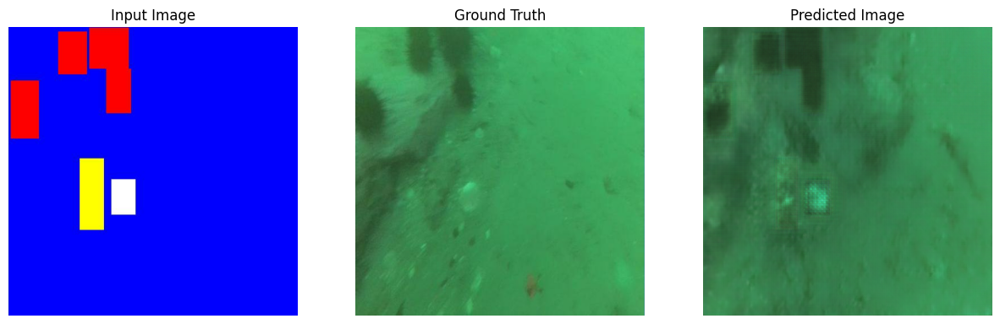

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 17.4308 - disc_loss: 0.7506
Epoch 45/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.4948 - disc_loss: 0.7564

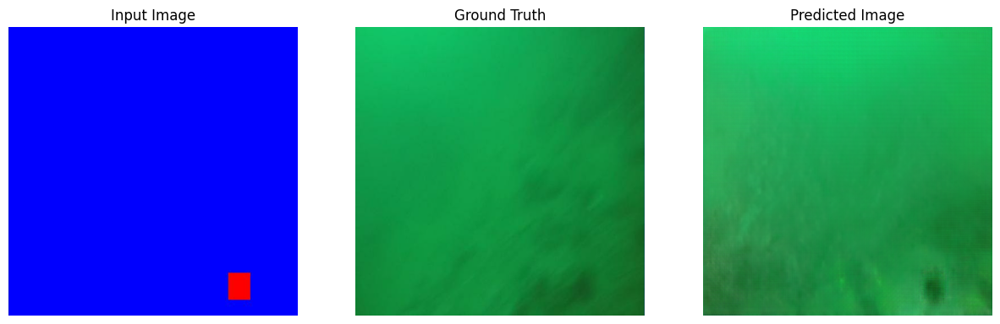

2115/2115 [==============================] - 739s 349ms/step - gen_total_loss: 17.4943 - disc_loss: 0.7561
Epoch 46/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.4456 - disc_loss: 0.7474

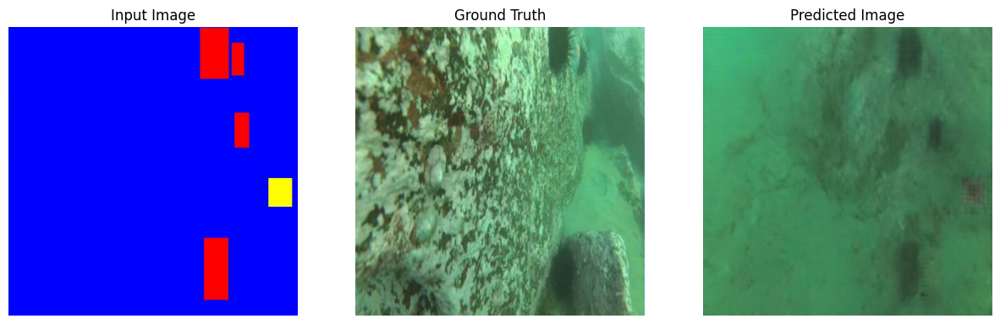

2115/2115 [==============================] - 741s 349ms/step - gen_total_loss: 17.4463 - disc_loss: 0.7475
Epoch 47/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.2771 - disc_loss: 0.7566

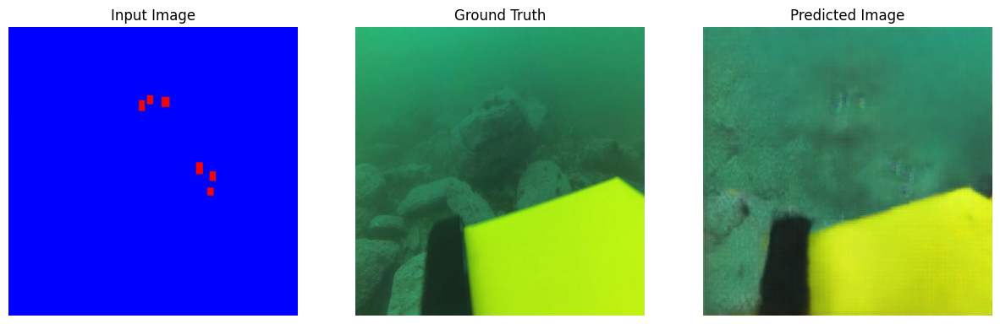

2115/2115 [==============================] - 737s 348ms/step - gen_total_loss: 17.2756 - disc_loss: 0.7568
Epoch 48/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.2724 - disc_loss: 0.7510

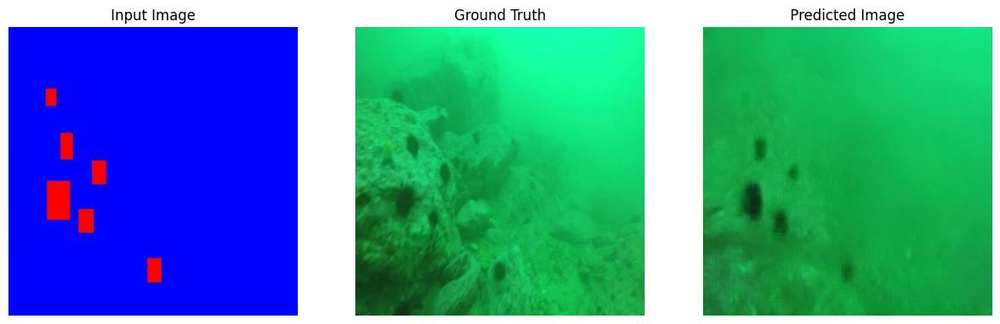

2115/2115 [==============================] - 735s 347ms/step - gen_total_loss: 17.2731 - disc_loss: 0.7507
Epoch 49/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.2224 - disc_loss: 0.7499

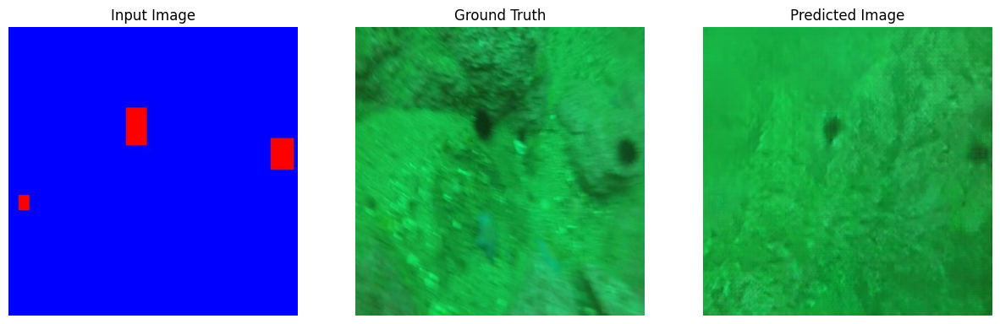

2115/2115 [==============================] - 736s 347ms/step - gen_total_loss: 17.2202 - disc_loss: 0.7496
Epoch 50/50
2115/2115 [==============================] - ETA: 0s - gen_total_loss: 17.1212 - disc_loss: 0.7461

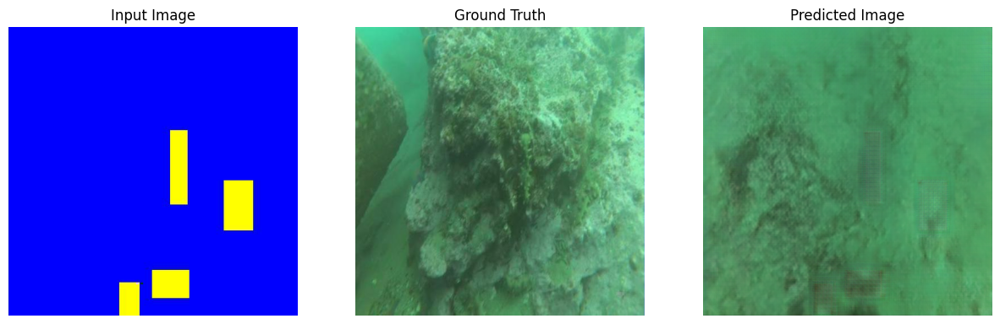

2115/2115 [==============================] - 738s 348ms/step - gen_total_loss: 17.1187 - disc_loss: 0.7461


In [19]:
import os

NUM_EPOCHS = 50
metric_history = []

model_directory = 'path_to_save_model'

# Crear el directorio si no existe
if not os.path.exists(model_directory):
    os.makedirs(model_directory)
    
model = Pix2Pix(generator, discriminator)
model.compile(
    g_optimizer=tf.keras.optimizers.Adam(2e-4, beta_1=0.5),
    d_optimizer=tf.keras.optimizers.Adam(2e-4, beta_1=0.5),
    gen_loss_fn=generator_loss,
    disc_loss_fn=discriminator_loss)

epoch_end_callback = LambdaCallback(on_epoch_end=on_epoch_end_callback)

# Entrenar el modelo
history = model.fit(
    train_dataset, 
    epochs=NUM_EPOCHS,
    callbacks=[ epoch_end_callback]
)

# Después de finalizar el entrenamiento, puedes procesar 'history' para ver la evolución de las métricas
metric_history = history.history

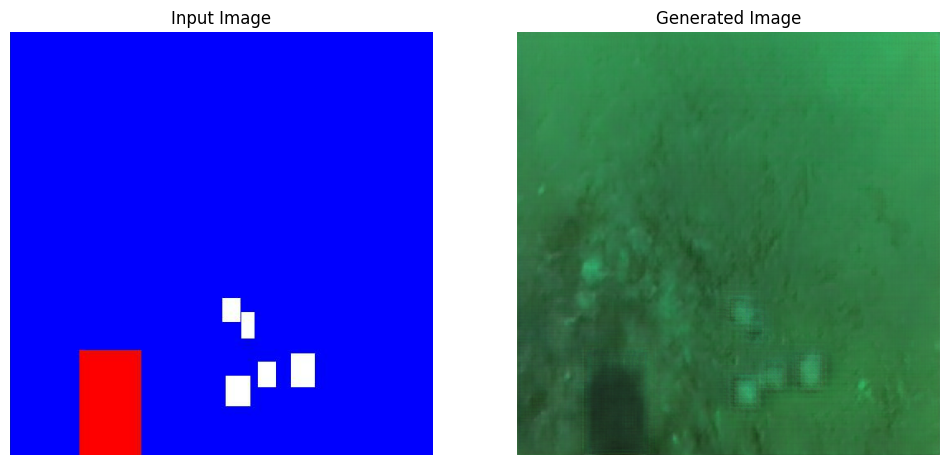

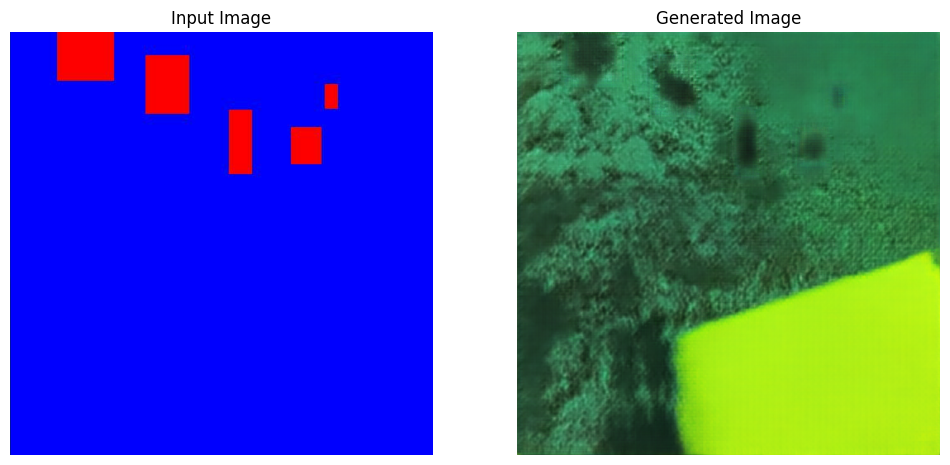

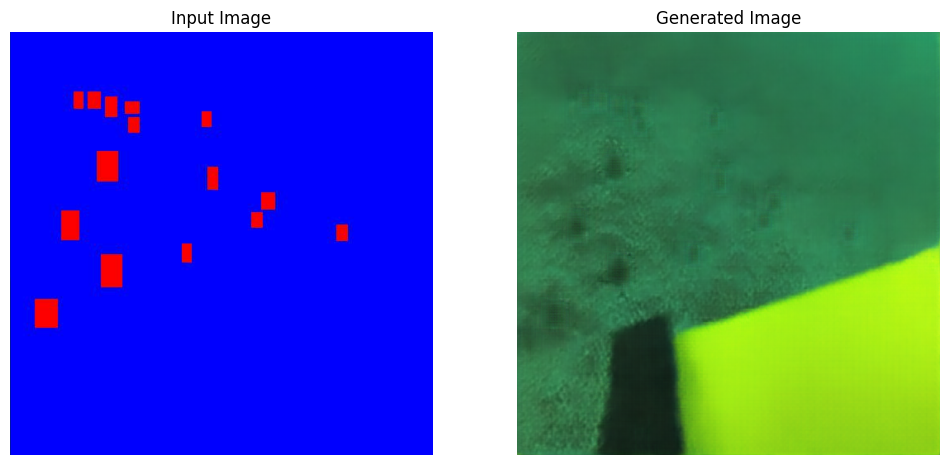

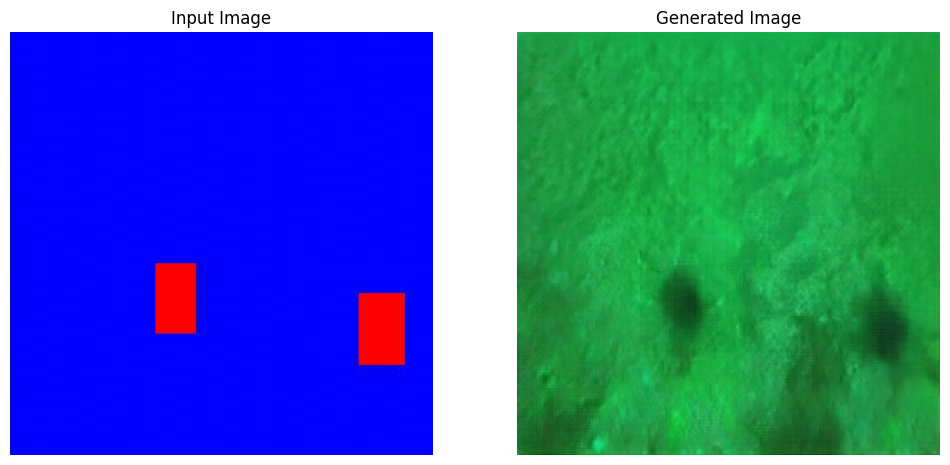

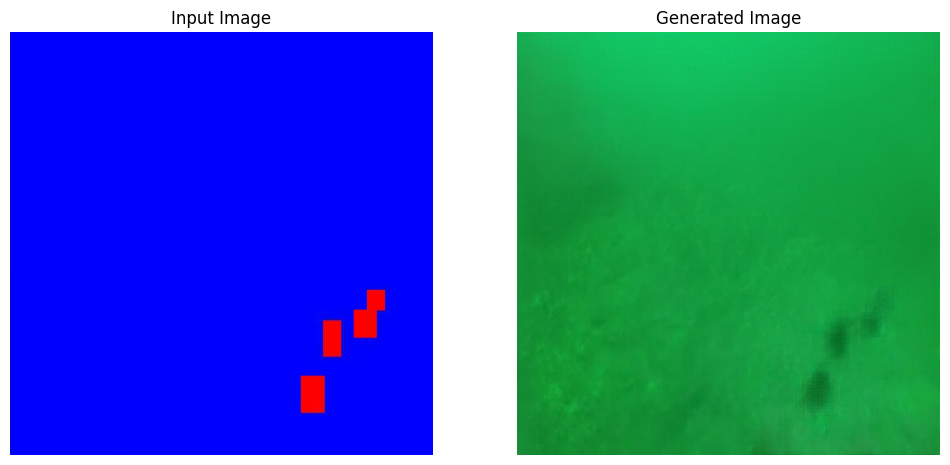

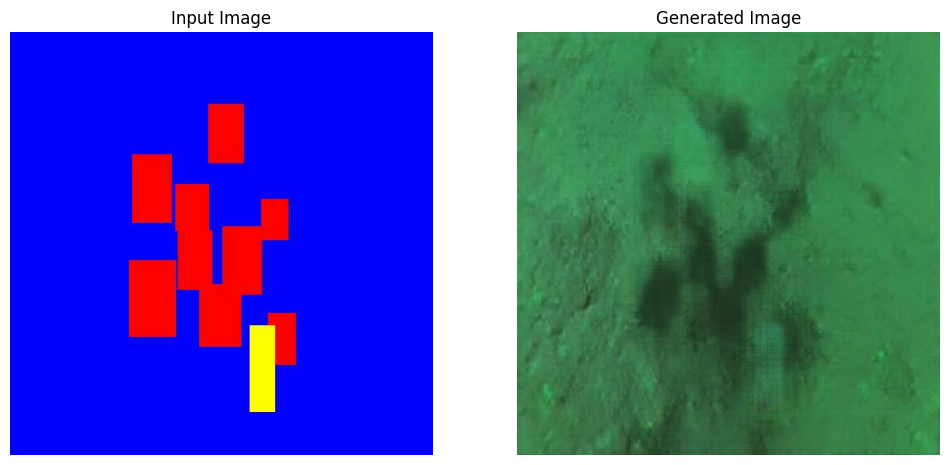

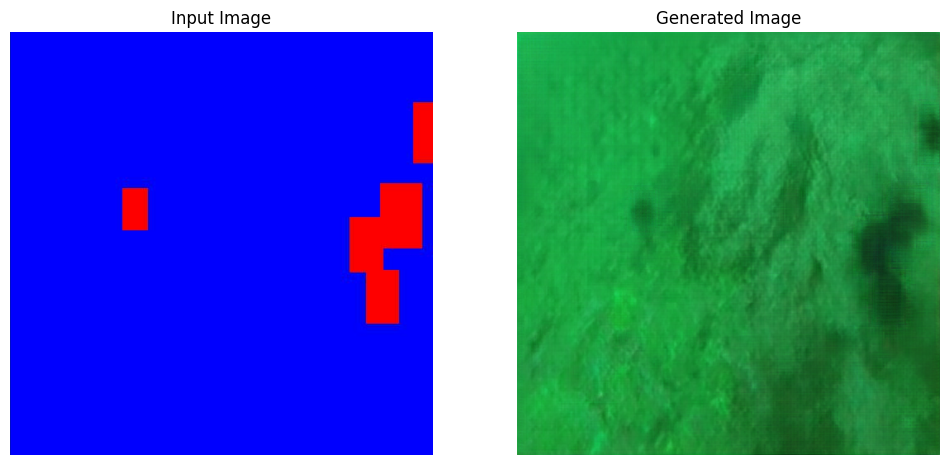

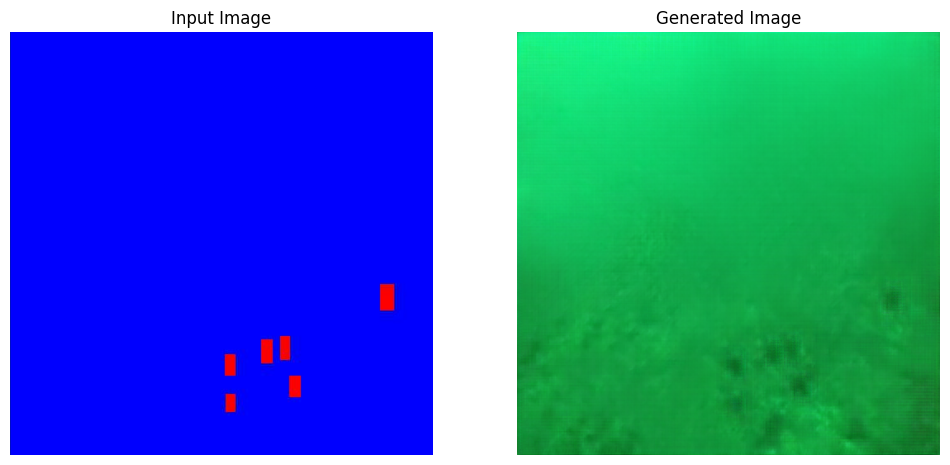

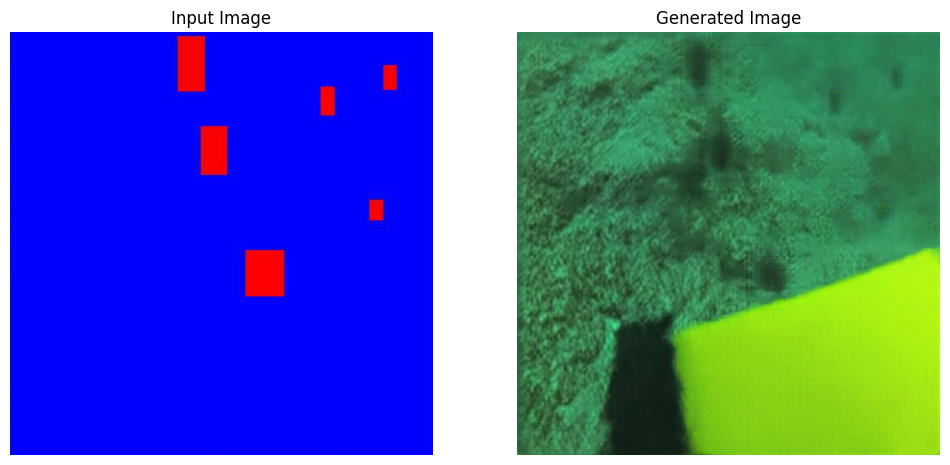

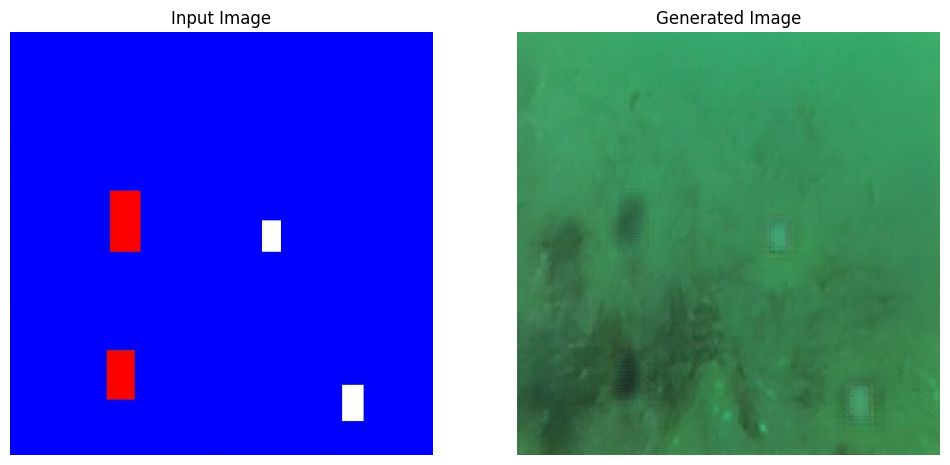

In [20]:
# Asumiendo que `model` es tu modelo Pix2Pix entrenado y `test_dataset` es tu conjunto de datos
# Seleccionar 10 muestras aleatorias del conjunto de datos
for i, (input_image, _) in enumerate(test_dataset.take(10)):
    # Generar la imagen
    generated_image = model(input_image, training=False)

    # Visualizar la imagen de entrada y la imagen generada
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.title('Input Image')
    plt.imshow(input_image[0] * 0.5 + 0.5)  # Reajustar la normalización si es necesario
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.title('Generated Image')
    plt.imshow(generated_image[0] * 0.5 + 0.5)  # Reajustar la normalización si es necesario
    plt.axis('off')

    plt.show()

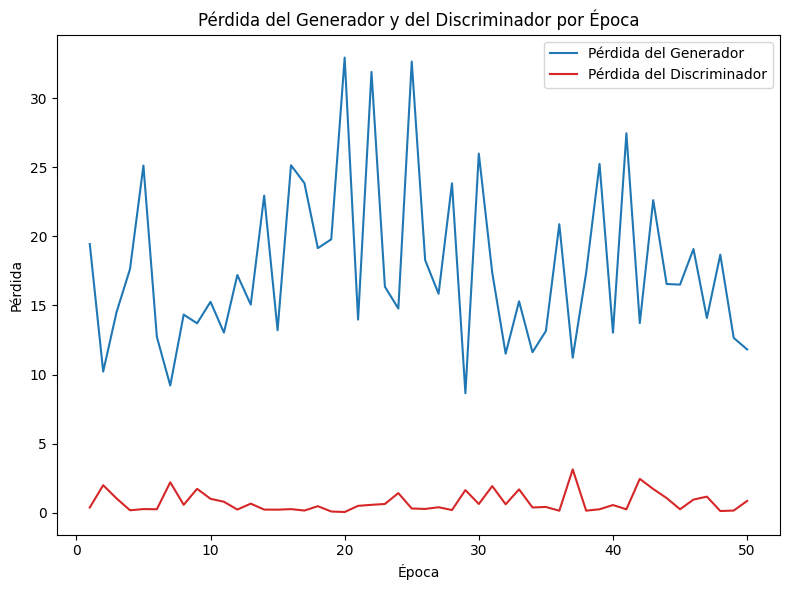

In [25]:
def plot_training_metrics(history):
    # Extraer métricas
    gen_loss = history['gen_total_loss']
    disc_loss = history['disc_loss']

    # Configurar el rango de épocas
    epochs = range(1, len(gen_loss) + 1)

    # Crear gráfico
    plt.figure(figsize=(8, 6))

    plt.plot(epochs, gen_loss, label='Pérdida del Generador', color='tab:blue')
    plt.plot(epochs, disc_loss, label='Pérdida del Discriminador', color='tab:red')

    plt.title('Pérdida del Generador y del Discriminador por Época')
    plt.xlabel('Época')
    plt.ylabel('Pérdida')
    plt.legend()

    plt.tight_layout()
    plt.show()

# Llamar a la función con los datos de entrenamiento
plot_training_metrics(metric_history)